In [2]:
import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [2]:
!pip install -q git+https://github.com/huggingface/transformers.git

^C
ERROR: Operation cancelled by user


## finetune sam 

In [12]:
example_img.shape

(640, 640, 3)

(239, 304) 23 24


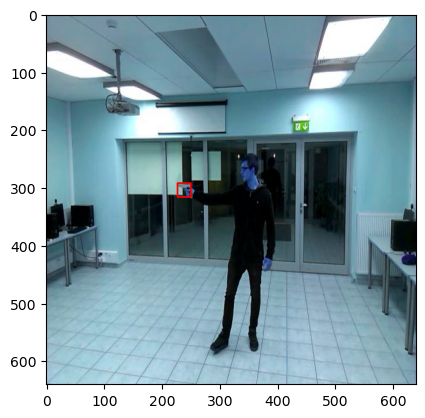

In [29]:
#/home/maxine/Documents/louis/Imaging-updated/vimm/cctv-data/train/images/gmd_1_frame6_jpg.rf.8856761f366d26ec58bffe9f89f70414.jpg
example_img = cv2.imread('cctv-data/train/images/gmd_1_frame6_jpg.rf.8856761f366d26ec58bffe9f89f70414.jpg')
w, h, c = example_img.shape

example_bbox = open(file='cctv-data/train/labels/gmd_1_frame6_jpg.rf.8856761f366d26ec58bffe9f89f70414.txt', mode="r").read().split(' ')
example_bbox = [float(el) for el in example_bbox]
center = int(example_bbox[1]*w), int(example_bbox[2]*h)
box_width, box_height =  int(example_bbox[3]*w), int(example_bbox[4]*h)

print(center, box_width, box_height)
starting_point = int(center[0] - box_width/2), int(center[1] - box_height/2)
end_point = int(center[0] + box_width/2), int(center[1] + box_height/2)
drawn = cv2.rectangle(example_img,starting_point, end_point,
                       color=(255, 0, 0), thickness=2)
plt.imshow(drawn)
plt.show()

In [2]:
!pip install -q 'git+https://github.com/facebookresearch/segment-anything.git'

In [3]:
from segment_anything import sam_model_registry, SamAutomaticMaskGenerator, SamPredictor

In [5]:
!wget -q https://dl.fbaipublicfiles.com/segment_anything/sam_vit_h_4b8939.pth -P weights/

In [4]:
import torch
import os
DEVICE = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu')
MODEL_TYPE = "vit_h"
CHECKPOINT_PATH = os.path.join("weights", "sam_vit_h_4b8939.pth")

sam = sam_model_registry[MODEL_TYPE](checkpoint=CHECKPOINT_PATH).to(device=DEVICE)
mask_predictor = SamPredictor(sam)

In [6]:
mask_generator = SamAutomaticMaskGenerator(sam)

In [7]:
import cv2
import numpy as np
import supervision as sv

image_bgr = cv2.imread('cctv-data/train/images/gmd_1_frame6_jpg.rf.8856761f366d26ec58bffe9f89f70414.jpg')
image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

sam_result = mask_generator.generate(image_rgb)

In [8]:
import matplotlib.pyplot as plt

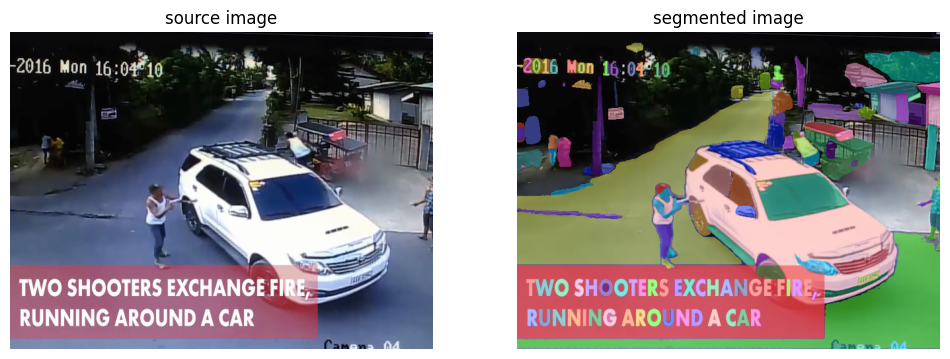

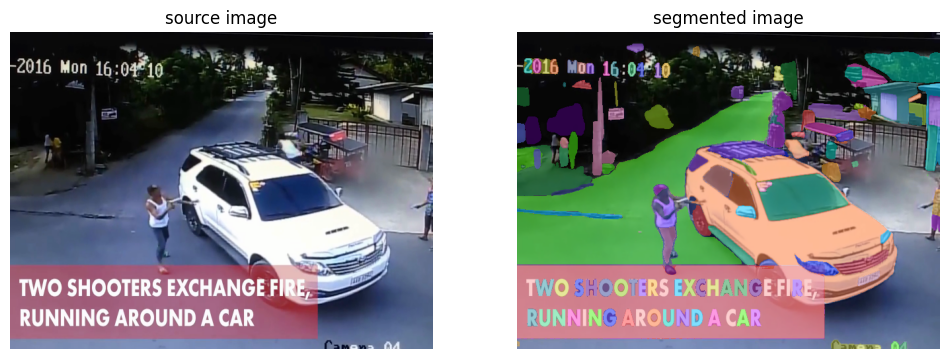

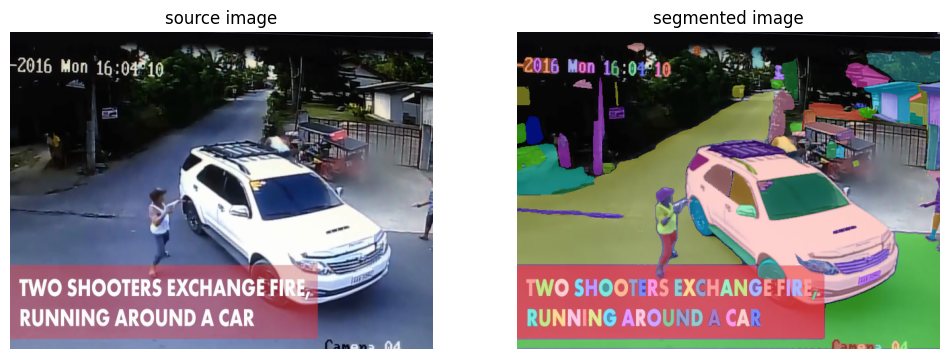

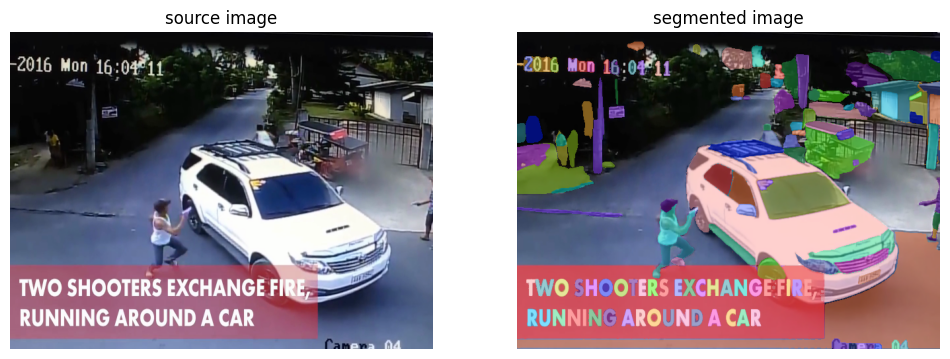

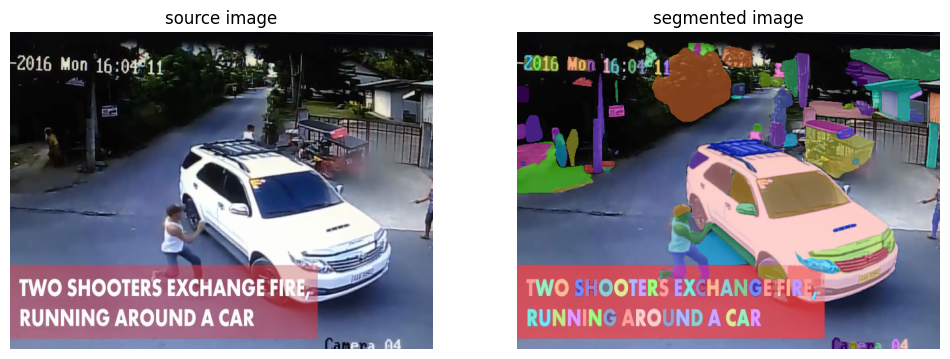

In [11]:
img_dir = 'frame-data/0/images/'
list_of_images2 = sorted(os.listdir(img_dir))

for img_path in list_of_images2[20:25]:
    image_bgr = cv2.imread(img_dir + img_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    sam_result = mask_generator.generate(image_rgb)
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

    detections = sv.Detections.from_sam(sam_result=sam_result)

    annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

    sv.plot_images_grid(
        images=[image_bgr, annotated_image],
        grid_size=(1, 2),
        titles=['source image', 'segmented image']
    )
    plt.show()


In [15]:
img_dir = 'cctv-data/train/images/'
list_of_images = os.listdir('cctv-data/train/images/')
list_of_images[:2]

['gmd_1_frame74_jpg.rf.97e64219df6d595ade4015d8b70b265f.jpg',
 'mock_attack_frame562_jpg.rf.45c430c44d9d58d134a3490c80a63795.jpg']

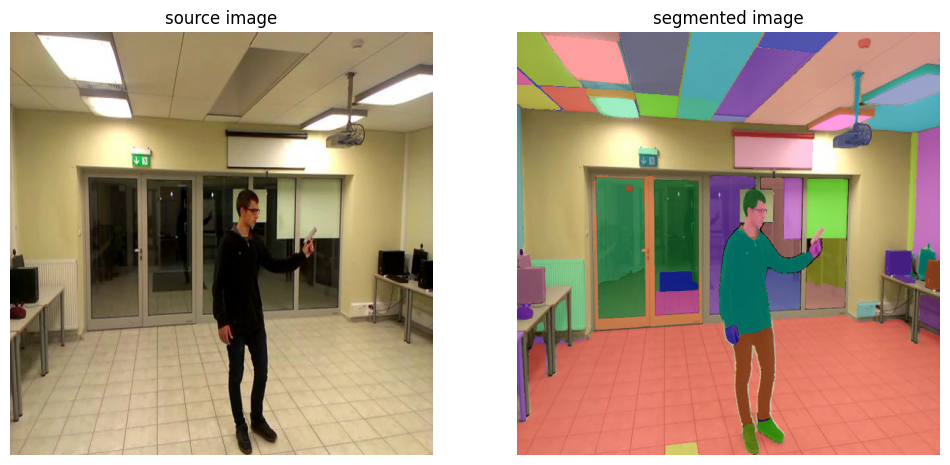

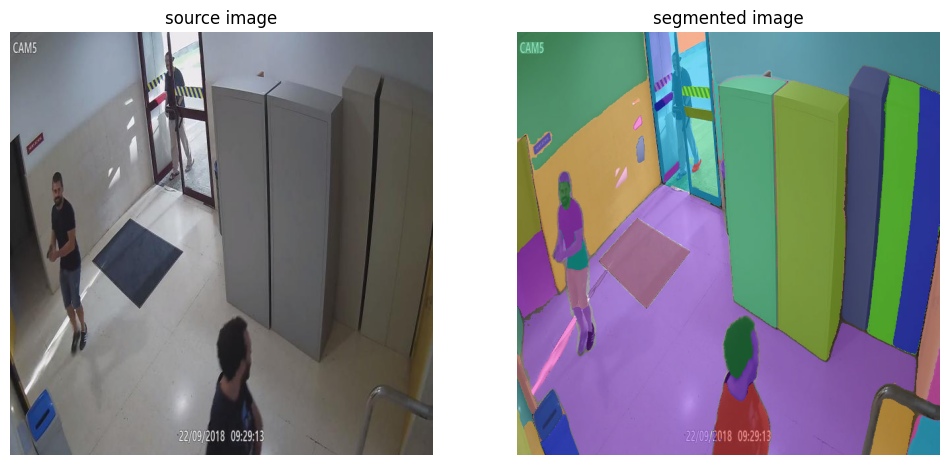

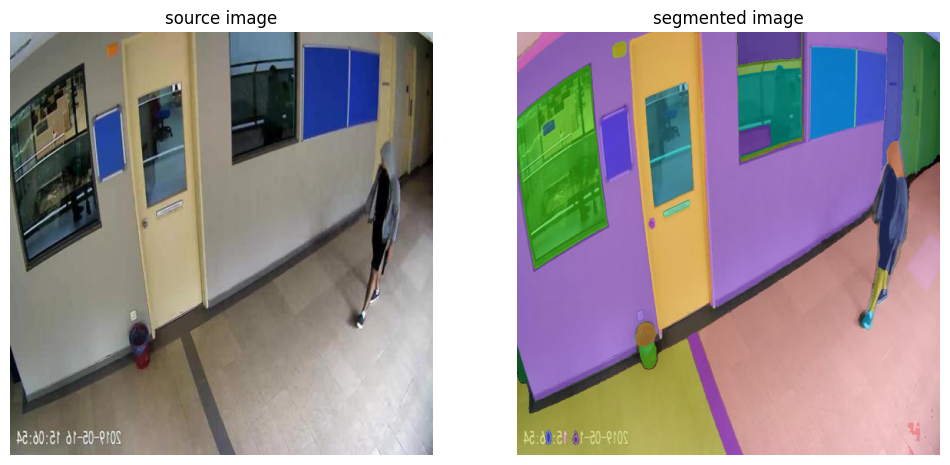

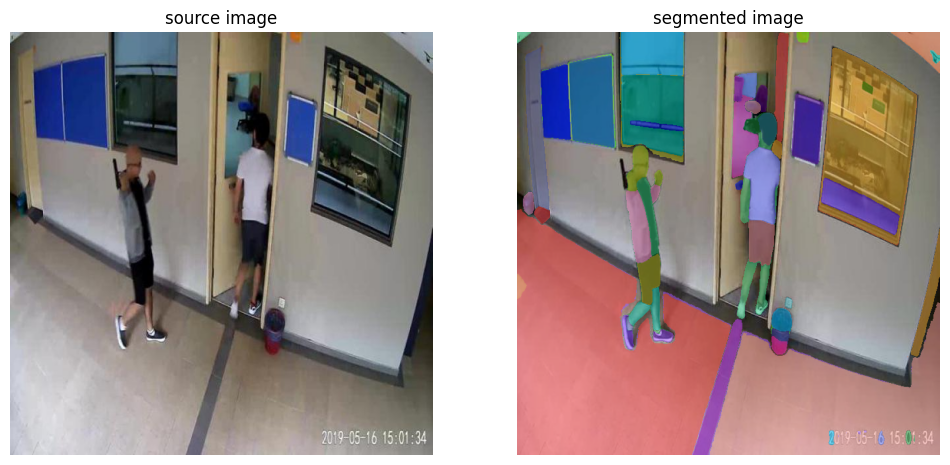

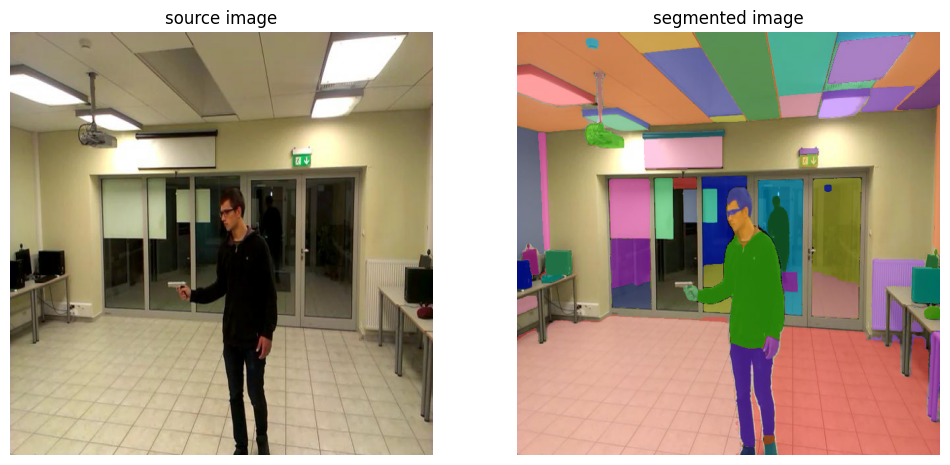

...

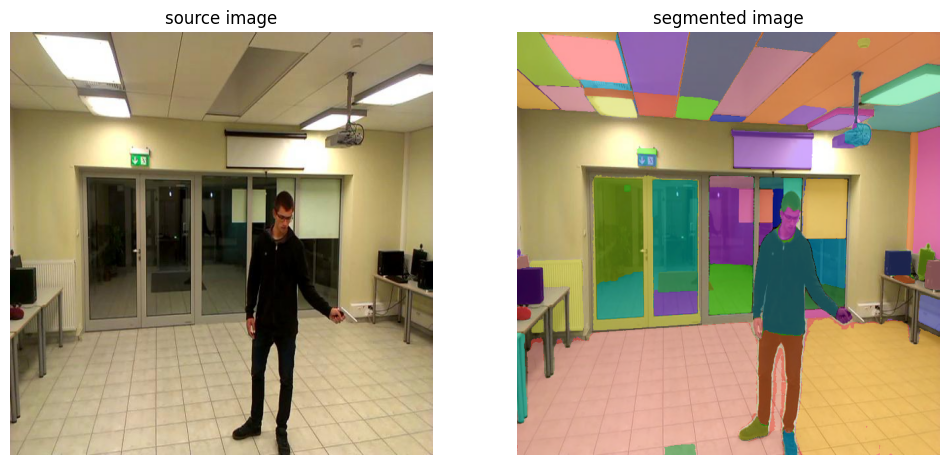

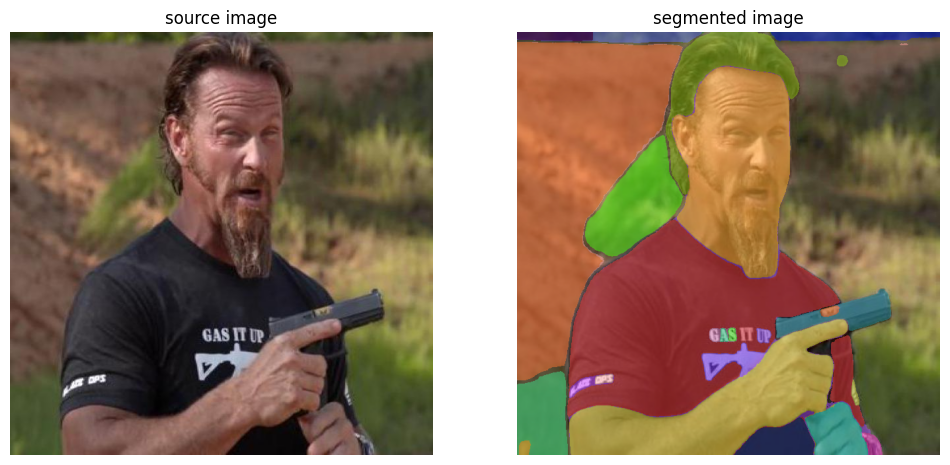

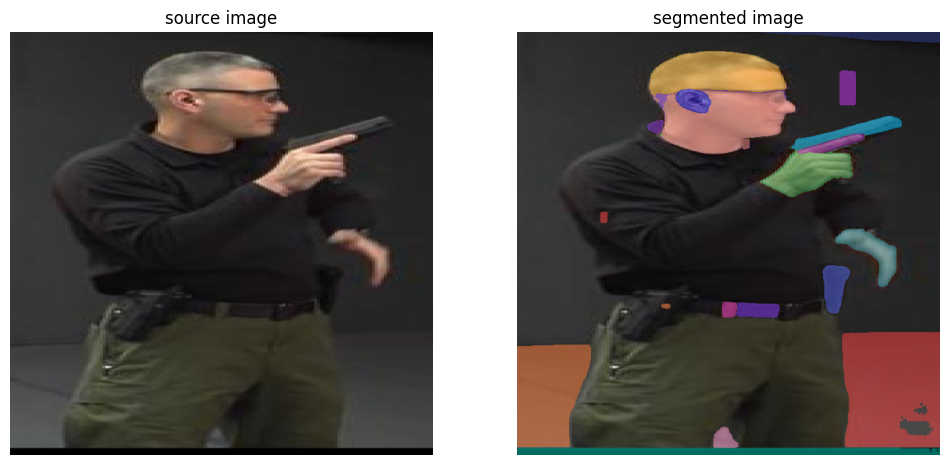

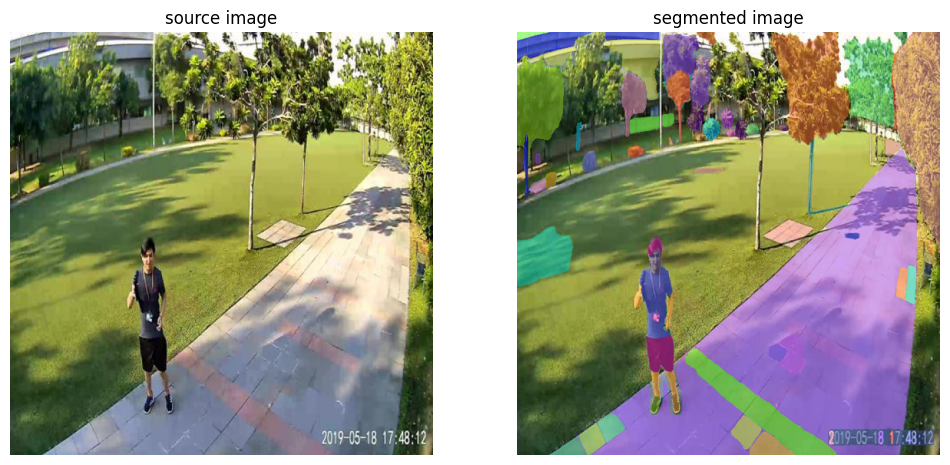

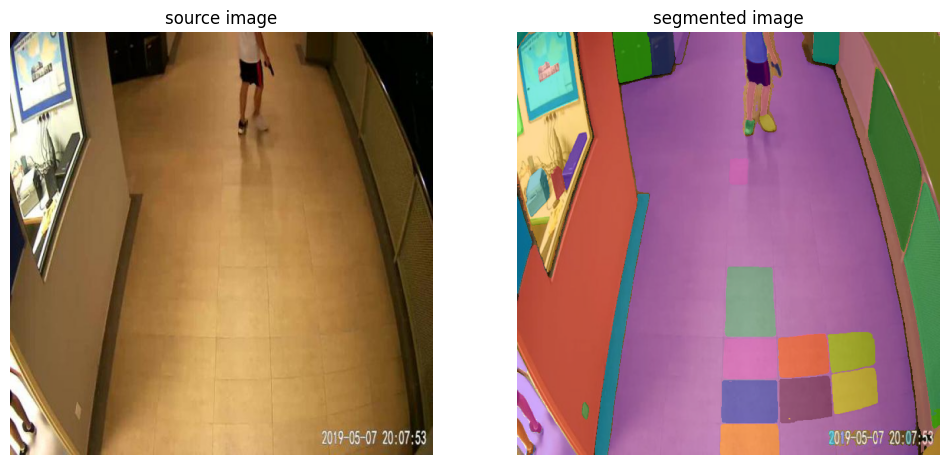

KeyboardInterrupt: 

In [19]:
for img_path in list_of_images[:100]:
    image_bgr = cv2.imread(img_dir + img_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    sam_result = mask_generator.generate(image_rgb)
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

    detections = sv.Detections.from_sam(sam_result=sam_result)

    annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

    sv.plot_images_grid(
        images=[image_bgr, annotated_image],
        grid_size=(1, 2),
        titles=['source image', 'segmented image']
    )
    plt.show()

In [ ]:
for img_path in list_of_images[:100]:
    image_bgr = cv2.imread(img_dir + img_path)
    image_rgb = cv2.cvtColor(image_bgr, cv2.COLOR_BGR2RGB)

    sam_result = mask_generator.generate(image_rgb)
    mask_annotator = sv.MaskAnnotator(color_lookup=sv.ColorLookup.INDEX)

    detections = sv.Detections.from_sam(sam_result=sam_result)

    annotated_image = mask_annotator.annotate(scene=image_bgr.copy(), detections=detections)

    sv.plot_images_grid(
        images=[image_bgr, annotated_image],
        grid_size=(1, 2),
        titles=['source image', 'segmented image']
    )
    plt.show()
